In [27]:
import pandas as pd

# Primera Descarga

df1 = pd.read_csv("main.csv")
df2 = pd.read_csv("address.csv")
df3 = pd.read_csv("paid_record.csv")

In [28]:
df1.FLAG_WORK_PHONE.value_counts()

0.0    339555
1.0     88160
Name: FLAG_WORK_PHONE, dtype: int64

In [29]:
df1.head()

,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,DAYS_BIRTH_CLEAN,Letter,Main_ID
0,M,Y,Y,0.0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-4542.0,1.0,1.0,0.0,0.0,NaN,2.0,09/04/1990,L,5008804
1,M,Y,Y,0.0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-4542.0,1.0,1.0,0.0,0.0,NaN,2.0,09/04/1990,G,5008805
2,M,Y,Y,0.0,112500.0,Working,Secondary / secondary special,Married,House / apartment,-1134.0,1.0,0.0,0.0,0.0,Security staff,2.0,06/05/1964,D,5008806
3,F,N,Y,0.0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-3051.0,1.0,0.0,1.0,1.0,Sales staff,1.0,26/10/1970,I,5008808
4,F,NaN,Y,0.0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-3051.0,1.0,0.0,1.0,1.0,Sales staff,1.0,26/10/1970,Z,5008809


In [30]:
df1['Main_ID'].value_counts()

5008804    2
5008986    2
5008967    2
5008971    2
5008973    2
          ..
6620863    1
6620862    1
6620861    1
6620858    1
6842885    1
Name: Main_ID, Length: 438510, dtype: int64

In [31]:
df1 = df1.drop_duplicates(subset=['Main_ID'])
df1['Main_ID'].value_counts()


5008804    1
6358498    1
6358496    1
6358493    1
6358492    1
          ..
5690727    1
6621262    1
6621261    1
6621260    1
6842885    1
Name: Main_ID, Length: 438510, dtype: int64

In [32]:
df2.head()

,New_ID,ADDRESS
0,5008804L,"06042, CT, 31 Mitchell Road"
1,5008805G,"72703, AR, 1189 Northwest End Avenue"
2,5008806D,"72701, AR, 218 Shipley Alley"
3,5008808I,"3138 P Street Northwest, 20007, DC"
4,5008809Z,"2405 230th Street, 21122, MD"


In [33]:
df2['New_ID'].value_counts()

6395895     2
6601737     2
6481789     2
6544779     2
6661349     2
           ..
6620970Z    1
6620969O    1
6620968O    1
5690743D    1
5969568Q    1
Name: New_ID, Length: 438652, dtype: int64

In [34]:
#Taking the letter out of the ID to merge df1 and df2
df2['New_ID'] = df2['New_ID'].str.extract('(\d+)').astype(int)
df2['New_ID']

0         5008804
1         5008805
2         5008806
3         5008808
4         5008809
           ...   
438752    5680433
438753    5353755
438754    5689895
438755    5833391
438756    6395895
Name: New_ID, Length: 438757, dtype: int32

In [35]:
df2 = df2.drop_duplicates(subset=['New_ID'])
df2['New_ID'].value_counts()

5008804    1
6358498    1
6358496    1
6358493    1
6358492    1
          ..
5690727    1
6621262    1
6621261    1
6621260    1
6842885    1
Name: New_ID, Length: 438510, dtype: int64

In [36]:
#Renaming key columns
df1.rename(columns={'Main_ID': 'ID'}, inplace=True)
df2.rename(columns={'New_ID': 'ID'}, inplace=True)

In [37]:
df = pd.merge(df1, df2, on='ID', how='left')
df.head()

,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,DAYS_BIRTH_CLEAN,Letter,ID,ADDRESS
0,M,Y,Y,0.0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-4542.0,1.0,1.0,0.0,0.0,NaN,2.0,09/04/1990,L,5008804,"06042, CT, 31 Mitchell Road"
1,M,Y,Y,0.0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-4542.0,1.0,1.0,0.0,0.0,NaN,2.0,09/04/1990,G,5008805,"72703, AR, 1189 Northwest End Avenue"
2,M,Y,Y,0.0,112500.0,Working,Secondary / secondary special,Married,House / apartment,-1134.0,1.0,0.0,0.0,0.0,Security staff,2.0,06/05/1964,D,5008806,"72701, AR, 218 Shipley Alley"
3,F,N,Y,0.0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-3051.0,1.0,0.0,1.0,1.0,Sales staff,1.0,26/10/1970,I,5008808,"3138 P Street Northwest, 20007, DC"
4,F,NaN,Y,0.0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-3051.0,1.0,0.0,1.0,1.0,Sales staff,1.0,26/10/1970,Z,5008809,"2405 230th Street, 21122, MD"


In [38]:
df = df.drop_duplicates(subset=['ID'])

In [39]:
df['ID'].value_counts()

5008804    1
6358498    1
6358496    1
6358493    1
6358492    1
          ..
5690727    1
6621262    1
6621261    1
6621260    1
6842885    1
Name: ID, Length: 438510, dtype: int64

In [40]:
df[df['ID'] == 6510063]

,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,DAYS_BIRTH_CLEAN,Letter,ID,ADDRESS
364033,F,N,Y,0.0,94500.0,Pensioner,Secondary / secondary special,Civil marriage,House / apartment,365243.0,1.0,0.0,0.0,0.0,NaN,2.0,NaN,P,6510063,"20764, MD, 5222 Nick Road"


CHECKING FOR NULL VALUES

In [41]:
# Percentage of null values per column
percent_missing = df.isnull().sum() * 100 / len(df)
print(percent_missing)

CODE_GENDER             2.475884
FLAG_OWN_CAR            2.518757
FLAG_OWN_REALTY         2.496180
CNT_CHILDREN            2.491163
AMT_INCOME_TOTAL        2.537684
NAME_INCOME_TYPE        2.516704
NAME_EDUCATION_TYPE     2.531299
NAME_FAMILY_STATUS      2.504618
NAME_HOUSING_TYPE       2.521721
DAYS_EMPLOYED           2.501197
FLAG_MOBIL              2.522862
FLAG_WORK_PHONE         2.516476
FLAG_PHONE              2.525370
FLAG_EMAIL              2.503478
OCCUPATION_TYPE        32.320130
CNT_FAM_MEMBERS         2.492303
DAYS_BIRTH_CLEAN        2.442134
Letter                  0.000000
ID                      0.000000
ADDRESS                 0.000000
dtype: float64


In [42]:
import plotly.express as px
values = df['OCCUPATION_TYPE'].value_counts().values
fig = px.bar(x=df['OCCUPATION_TYPE'].value_counts().index, 
            y=df['OCCUPATION_TYPE'].value_counts().values,
            color=values,
            color_continuous_scale='Blues')

fig.update_layout(title="Occupation type", 
                xaxis_title="Occupation", 
                yaxis_title="Amount",
                template = 'plotly_dark',
                
                )
fig.show()

import plotly.io as pio


# save the plot to an HTML file
# pio.write_html(fig, file='occupationtype.html', auto_open=False)

DROPPING OCCUPATION TYPE AS IT IS UNUSABLE

In [43]:
df = df.drop('OCCUPATION_TYPE', axis=1)

DROPPING LETTER AS IT IS NOT USEFUL

In [44]:
df = df.drop('Letter', axis=1)
df.head()

,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,DAYS_BIRTH_CLEAN,ID,ADDRESS
0,M,Y,Y,0.0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-4542.0,1.0,1.0,0.0,0.0,2.0,09/04/1990,5008804,"06042, CT, 31 Mitchell Road"
1,M,Y,Y,0.0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-4542.0,1.0,1.0,0.0,0.0,2.0,09/04/1990,5008805,"72703, AR, 1189 Northwest End Avenue"
2,M,Y,Y,0.0,112500.0,Working,Secondary / secondary special,Married,House / apartment,-1134.0,1.0,0.0,0.0,0.0,2.0,06/05/1964,5008806,"72701, AR, 218 Shipley Alley"
3,F,N,Y,0.0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-3051.0,1.0,0.0,1.0,1.0,1.0,26/10/1970,5008808,"3138 P Street Northwest, 20007, DC"
4,F,NaN,Y,0.0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-3051.0,1.0,0.0,1.0,1.0,1.0,26/10/1970,5008809,"2405 230th Street, 21122, MD"


CHECKING FOR OUTLIERS IN NUMERICAL COLUMNS

In [45]:
import plotly.express as px
fig = px.box(df, y="CNT_CHILDREN", 
                width = 800, 
                labels={"CNT_CHILDREN":"Children"}, 
                title='Children outliers')
fig.update_traces(marker_color='blue')
fig.show()

# save the plot to an HTML file
import plotly.io as pio
# pio.write_html(fig, file='childrenoutliersbefore.html', auto_open=False)

In [46]:
fig = px.box(df, y="AMT_INCOME_TOTAL", 
                width = 800, 
                labels={"AMT_INCOME_TOTAL":"Anual Income"}, 
                title='Income outliers')
fig.update_traces(marker_color='blue')
fig.show()
import plotly.io as pio
# pio.write_html(fig, file='incomeoutliersbefore.html', auto_open=False)

In [47]:
def outliers_repair (df):
    """
    outliers_repair: se usa para identificar y reparar valores atípicos en un DataFrame dado.
    param df: DataFrame para el cual se deben reparar los valores atípicos.
    returns: dataFrame sin valores atípicos.
    """
    Q1 = df.quantile(0.10)
    Q3 = df.quantile(0.90)
    IQR = Q3 - Q1

    outliers = (df < (Q1 - 1.5 * IQR)) | (df > (Q3 + 1.5 * IQR))

    dataset_wo_outliers = df.copy()
    dataset_wo_outliers = pd.DataFrame(df)
    for col in df.columns:
        moda = df[col].mode()[0]
        dataset_wo_outliers.loc[outliers[col], col] = moda
        

    return dataset_wo_outliers

df = outliers_repair(df)
df.head()

C:\Users\lluri\AppData\Local\Temp\ipykernel_1564\3123526589.py:7: FutureWarning:

The default value of numeric_only in DataFrame.quantile is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.

C:\Users\lluri\AppData\Local\Temp\ipykernel_1564\3123526589.py:8: FutureWarning:

The default value of numeric_only in DataFrame.quantile is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.

C:\Users\lluri\AppData\Local\Temp\ipykernel_1564\3123526589.py:11: FutureWarning:

Automatic reindexing on DataFrame vs Series comparisons is deprecated and will raise ValueError in a future version. Do `left, right = left.align(right, axis=1, copy=False)` before e.g. `left == right`



,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,DAYS_BIRTH_CLEAN,ID,ADDRESS
0,M,Y,Y,0.0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-4542.0,1.0,1.0,0.0,0.0,2.0,09/04/1990,5008804,"06042, CT, 31 Mitchell Road"
1,M,Y,Y,0.0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-4542.0,1.0,1.0,0.0,0.0,2.0,09/04/1990,5008805,"72703, AR, 1189 Northwest End Avenue"
2,M,Y,Y,0.0,112500.0,Working,Secondary / secondary special,Married,House / apartment,-1134.0,1.0,0.0,0.0,0.0,2.0,06/05/1964,5008806,"72701, AR, 218 Shipley Alley"
3,F,N,Y,0.0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-3051.0,1.0,0.0,1.0,1.0,1.0,26/10/1970,5008808,"3138 P Street Northwest, 20007, DC"
4,F,NaN,Y,0.0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-3051.0,1.0,0.0,1.0,1.0,1.0,26/10/1970,5008809,"2405 230th Street, 21122, MD"


In [48]:
fig = px.box(df, y="AMT_INCOME_TOTAL", 
                width = 800, 
                labels={"AMT_INCOME_TOTAL":"Anual Income"}, 
                title='Income without outliers')
fig.update_traces(marker_color='blue')
fig.show()
import plotly.io as pio
#pio.write_html(fig, file='incomeoutliersafter.html', auto_open=False)

In [49]:
fig = px.box(df, y="CNT_CHILDREN", 
            width = 800, 
            labels={"CNT_CHILDREN":"Children"}, 
            title='Children without outliers')
fig.update_traces(marker_color='blue')
fig.show()

import plotly.io as pio
#pio.write_html(fig, file='childrenoutliersafter.html', auto_open=False)

REPARING CATEGORICAL COLUMNS REPRESENTED WITH NUMBERS' NULLS WITH THE MODE 

In [50]:
df['CNT_CHILDREN'] = df['CNT_CHILDREN'].fillna(df['CNT_CHILDREN'].mode()[0])
df['FLAG_MOBIL'] = df['FLAG_MOBIL'].fillna(df['FLAG_MOBIL'].mode()[0])
df['FLAG_WORK_PHONE'] = df['FLAG_WORK_PHONE'].fillna(df['FLAG_WORK_PHONE'].mode()[0])
df['FLAG_PHONE'] = df['FLAG_PHONE'].fillna(df['FLAG_PHONE'].mode()[0])
df['FLAG_EMAIL'] = df['FLAG_EMAIL'].fillna(df['FLAG_EMAIL'].mode()[0])

REPARING NULLS AFTER OUTLIERS HAVE BEEN TREATED

In [51]:
def repair_null(df):
    """
    Repair null values in dataframe using mode if the column is categorical or mean if the column is numerical.
    """
    for col in df.columns:
        if df[col].dtype == 'object':
            df[col].fillna(df[col].mode()[0], inplace=True)
        else:
            df[col].fillna(df[col].mean(), inplace=True)
    return df

df = repair_null(df)
# checking results again
percent_missing = df.isnull().sum() * 100 / len(df)
print(percent_missing)

CODE_GENDER            0.0
FLAG_OWN_CAR           0.0
FLAG_OWN_REALTY        0.0
CNT_CHILDREN           0.0
AMT_INCOME_TOTAL       0.0
NAME_INCOME_TYPE       0.0
NAME_EDUCATION_TYPE    0.0
NAME_FAMILY_STATUS     0.0
NAME_HOUSING_TYPE      0.0
DAYS_EMPLOYED          0.0
FLAG_MOBIL             0.0
FLAG_WORK_PHONE        0.0
FLAG_PHONE             0.0
FLAG_EMAIL             0.0
CNT_FAM_MEMBERS        0.0
DAYS_BIRTH_CLEAN       0.0
ID                     0.0
ADDRESS                0.0
dtype: float64


In [52]:
import plotly.graph_objects as go
import plotly.express as px
proporcion = df["CODE_GENDER"].value_counts()

fig = px.pie(df, 
            values=(proporcion/len(df * 100)).values, 
            names=(proporcion/len(df * 100)).index,
            color_discrete_sequence=px.colors.sequential.Blues[::-2],
            hole=0.5)
fig.update_layout(title = "Gender Overview", template = 'plotly_dark')
fig.update_traces(textinfo='percent+label')
fig.show()
#save the plot to an HTML file
import plotly.io as pio
#pio.write_html(fig, file='genderoverview.html', auto_open=False)

In [53]:
import plotly.graph_objects as go
import plotly.express as px
import plotly.io as pio
proporcion = df["FLAG_OWN_CAR"].value_counts()
fig = px.pie(df, 
            values=(proporcion/len(df * 100)).values, 
            names=(proporcion/len(df * 100)).index,
            color_discrete_sequence=px.colors.sequential.Blues[::-2],
            hole=0.5)
fig.update_layout(title = "Car Ownership", template = 'plotly_dark')
fig.update_traces(textinfo='percent+label')
fig.show()


In [54]:
df['CNT_CHILDREN'].value_counts()

0.0    307430
1.0     86292
2.0     38889
3.0      5292
4.0       478
5.0       129
Name: CNT_CHILDREN, dtype: int64

In [55]:
df = df[df['CNT_CHILDREN'] != 0.427385]

In [56]:
df['CNT_CHILDREN'].value_counts()

0.0    307430
1.0     86292
2.0     38889
3.0      5292
4.0       478
5.0       129
Name: CNT_CHILDREN, dtype: int64

In [57]:
import plotly.express as px
values = df['CNT_CHILDREN'].value_counts().values
fig = px.bar(x=df['CNT_CHILDREN'].value_counts().index, 
            y=df['CNT_CHILDREN'].value_counts().values,
            color=values,
            color_continuous_scale='Blues')

fig.update_layout(title="Number of Children", 
                xaxis_title="Children", 
                yaxis_title="Amount",
                template = 'plotly_dark',
                
                )
fig.show()

import plotly.io as pio



In [58]:
proporcion = df["FLAG_OWN_REALTY"].value_counts()
fig = px.pie(df, 
            values=(proporcion/len(df * 100)).values, 
            names=(proporcion/len(df * 100)).index,
            color_discrete_sequence=px.colors.sequential.Blues[::-2],
            hole=0.5)
fig.update_layout(title = "Realty Ownership", template = 'plotly_dark')
fig.update_traces(textinfo='percent+label')
fig.show()

In [59]:
import plotly.express as px
import plotly.graph_objs as go


fig = px.histogram(df, x='AMT_INCOME_TOTAL', color='CODE_GENDER',
                    nbins=40, 
                    color_discrete_sequence=px.colors.sequential.Blues[::-3])

fig.update_layout(title='Distribution of Income', 
                    xaxis_title='Income', 
                    yaxis_title='Amount', 
                    template='plotly_dark')
fig.show()

In [60]:
df.columns

Index(['CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'CNT_CHILDREN',
       'AMT_INCOME_TOTAL', 'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE',
       'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE', 'DAYS_EMPLOYED',
       'FLAG_MOBIL', 'FLAG_WORK_PHONE', 'FLAG_PHONE', 'FLAG_EMAIL',
       'CNT_FAM_MEMBERS', 'DAYS_BIRTH_CLEAN', 'ID', 'ADDRESS'],
      dtype='object')

CONVERTING BIRTH DATE INTO AGE COLUMN

In [61]:
import datetime as dt
#Converting column into datetime format
df['DAYS_BIRTH_CLEAN'] = pd.to_datetime(df['DAYS_BIRTH_CLEAN'])
#Creating variable for today
today = dt.datetime.now()
#Substract DoB to today's date and round to get Age variable
df['age'] = round((today - pd.to_datetime(df['DAYS_BIRTH_CLEAN'])).dt.days / 365)
#Drop DoB column
df = df.drop('DAYS_BIRTH_CLEAN', axis=1)
df.head()


C:\Users\lluri\AppData\Local\Temp\ipykernel_1564\824476194.py:3: UserWarning:

Parsing dates in DD/MM/YYYY format when dayfirst=False (the default) was specified. This may lead to inconsistently parsed dates! Specify a format to ensure consistent parsing.



,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,ID,ADDRESS,age
0,M,Y,Y,0.0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-4542.0,1.0,1.0,0.0,0.0,2.0,5008804,"06042, CT, 31 Mitchell Road",33.0
1,M,Y,Y,0.0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-4542.0,1.0,1.0,0.0,0.0,2.0,5008805,"72703, AR, 1189 Northwest End Avenue",33.0
2,M,Y,Y,0.0,112500.0,Working,Secondary / secondary special,Married,House / apartment,-1134.0,1.0,0.0,0.0,0.0,2.0,5008806,"72701, AR, 218 Shipley Alley",59.0
3,F,N,Y,0.0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-3051.0,1.0,0.0,1.0,1.0,1.0,5008808,"3138 P Street Northwest, 20007, DC",52.0
4,F,N,Y,0.0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-3051.0,1.0,0.0,1.0,1.0,1.0,5008809,"2405 230th Street, 21122, MD",52.0


In [62]:
import plotly.express as px
import plotly.graph_objs as go




fig = px.histogram(df, x='age', color='CODE_GENDER',
                    nbins=60,
                    color_discrete_sequence=px.colors.sequential.Blues[::-3])

fig.update_layout(title='Distribution of Age', 
                    xaxis_title='Age', 
                    yaxis_title='Amount', 
                    template='plotly_dark')
fig.show()

#save the plot to an HTML file
#pio.write_html(fig, file='agegender.html', auto_open=False)

In [63]:
import plotly.graph_objs as go
import pandas as pd
import numpy as np

# assuming your dataframe is named 'df' and the gender column is 'CODE_GENDER'
age_bins = np.arange(20, 80, 5)
df['age_bins'] = pd.cut(df['age'], bins=age_bins, include_lowest=True)

# count number of males and females in each age bin
male_counts = df[df['CODE_GENDER'] == 'M']['age_bins'].value_counts().sort_index()
female_counts = df[df['CODE_GENDER'] == 'F']['age_bins'].value_counts().sort_index()

# create custom color scale
colorscale = px.colors.sequential.Blues

# create the pyramid plotly graph
y = age_bins.astype(str)
layout = go.Layout(yaxis=go.layout.YAxis(title='Age'),
                    xaxis=go.layout.XAxis(
                        range=[-max(male_counts) - 1000, max(female_counts) + 1000],
                        tickvals=[-30000,-20000,-10000, 0, 10000, 20000, 30000, 40000],
                        ticktext=[30000,20000,10000, 0, 10000, 20000, 30000, 40000],
                        title='Number'),
                    barmode='overlay',
                    bargap=0.1)

data = [go.Bar(y=y,
                x=male_counts * -1,
                orientation='h',
                name='Men',
                #hoverinfo='text',
                text=male_counts.astype('int'),
                marker=dict(color=colorscale[-3])
                ),
        go.Bar(y=y,
                x=female_counts,
                orientation='h',
                name='Women',
                text=female_counts.astype('int'),
                #hoverinfo='text
                marker=dict(color=colorscale[-1])
                    )]

fig = go.Figure(data=data, layout=layout)
fig.update_layout(title='Distribution of Age', 
                    template='plotly_dark')
fig.show()


DROPPING 'age_bins' AFTER NO LONGER NEEDING IT

In [64]:
df = df.drop('age_bins', axis=1)

MAPPING BINARY CATEGORICAL VALUES WITH NUMERICAL VALUES

In [65]:
df = df.replace({'FLAG_OWN_REALTY':{'N': 0, 'Y':1}, 
            'FLAG_OWN_CAR':{'N':0, 'Y':1}, 
            'CODE_GENDER':{'M':0, 'F':1}})
df.head()

,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,ID,ADDRESS,age
0,0,1,1,0.0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-4542.0,1.0,1.0,0.0,0.0,2.0,5008804,"06042, CT, 31 Mitchell Road",33.0
1,0,1,1,0.0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-4542.0,1.0,1.0,0.0,0.0,2.0,5008805,"72703, AR, 1189 Northwest End Avenue",33.0
2,0,1,1,0.0,112500.0,Working,Secondary / secondary special,Married,House / apartment,-1134.0,1.0,0.0,0.0,0.0,2.0,5008806,"72701, AR, 218 Shipley Alley",59.0
3,1,0,1,0.0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-3051.0,1.0,0.0,1.0,1.0,1.0,5008808,"3138 P Street Northwest, 20007, DC",52.0
4,1,0,1,0.0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-3051.0,1.0,0.0,1.0,1.0,1.0,5008809,"2405 230th Street, 21122, MD",52.0


In [66]:
import plotly.express as px
values = df['NAME_EDUCATION_TYPE'].value_counts().values
fig = px.bar(x=df['NAME_EDUCATION_TYPE'].value_counts().index, 
            y=df['NAME_EDUCATION_TYPE'].value_counts().values,
            color=values,
            color_continuous_scale='Blues')

fig.update_layout(title="Education", 
                xaxis_title="Type", 
                yaxis_title="Amount",
                template = 'plotly_dark',
                
                )
fig.show()

import plotly.io as pio


#save the plot to an HTML file
#pio.write_html(fig, file='nameeducationtype.html', auto_open=False)

### FEATURE ENGINEERING FOR PAID RECORDS DATAFRAME

In [67]:
df3 = pd.read_csv('paid_record.csv')
df3.shape

(1048575, 3)

DROPPING ALL ROWS WHERE STATUS IS X SINCE IT DOESNT ADD INFORMATION

In [68]:
df3 = df3[df3['STATUS'] != 'X']
df3.shape

(839345, 3)

CREATING A COLUMN THAT CONTAINS AMOUNT OF TOTAL MONTHS

In [69]:
df3['count'] = df3.groupby('ID')['ID'].transform('count')
df3.head()

,ID,MONTHS_BALANCE,STATUS,count
1,5001711,-1,0,3
2,5001711,-2,0,3
3,5001711,-3,0,3
4,5001712,0,C,19
5,5001712,-1,C,19


CREATING A COLUMN THAT CONTAINS AMOUNT OF PAID MONTHS

In [70]:
import numpy as np
df3['paid'] = df3.groupby('ID')['STATUS'].transform(lambda x: np.sum(x == 'C'))
df3.head()

,ID,MONTHS_BALANCE,STATUS,count,paid
1,5001711,-1,0,3,0
2,5001711,-2,0,3,0
3,5001711,-3,0,3,0
4,5001712,0,C,19,9
5,5001712,-1,C,19,9


CREATING A COLUMN THAT CONTAINS THE RATIO OF PAID MONTHS TO TOTAL MONTHS

In [71]:
df3['ratio'] = df3['paid'] / df3['count']
df3.head()

,ID,MONTHS_BALANCE,STATUS,count,paid,ratio
1,5001711,-1,0,3,0,0.000000
2,5001711,-2,0,3,0,0.000000
3,5001711,-3,0,3,0,0.000000
4,5001712,0,C,19,9,0.473684
5,5001712,-1,C,19,9,0.473684


DROPPING ALL REPEATED ID ROWS
- Now that we have a ratio for each ID, we don't need the repeated ID rows

In [72]:
df3.drop_duplicates(subset=['ID'], keep='first', inplace=True)
df3.shape

(41449, 6)

MERGING DATASETS ON ID:
- Inner join to drop rows where ID doesn't have a ratio value

In [73]:
df = df.merge(df3, on='ID')
df.shape

(33110, 23)

CREATING TARGET COLUMN BASED ON RATIO: 
- **Threshold** is set to 0.8 but can be changed, which gives flexibility to our system

In [74]:
def umbral(row):
    if row['ratio'] >= 0.8:
        return 1
    else:
        return 0

df['target'] = df.apply(lambda row: umbral(row), axis=1)
df.head()

,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_EMPLOYED,...,CNT_FAM_MEMBERS,ID,ADDRESS,age,MONTHS_BALANCE,STATUS,count,paid,ratio,target
0,0,1,1,0.0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-4542.0,...,2.0,5008804,"06042, CT, 31 Mitchell Road",33.0,0,C,15,13,0.866667,1
1,0,1,1,0.0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-4542.0,...,2.0,5008805,"72703, AR, 1189 Northwest End Avenue",33.0,0,C,14,12,0.857143,1
2,0,1,1,0.0,112500.0,Working,Secondary / secondary special,Married,House / apartment,-1134.0,...,2.0,5008806,"72701, AR, 218 Shipley Alley",59.0,0,C,14,7,0.500000,0
3,1,0,1,0.0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-3051.0,...,1.0,5008808,"3138 P Street Northwest, 20007, DC",52.0,0,0,2,0,0.000000,0
4,1,0,1,0.0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-3051.0,...,1.0,5008810,"32404, FL, 7041 Coe Road",52.0,0,C,21,15,0.714286,0


#### FEATURE STUDY
- Delete columns not needed
- Determine columns not correlated with ratio
- Delete redundant columns

In [75]:
df.columns

Index(['CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'CNT_CHILDREN',
       'AMT_INCOME_TOTAL', 'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE',
       'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE', 'DAYS_EMPLOYED',
       'FLAG_MOBIL', 'FLAG_WORK_PHONE', 'FLAG_PHONE', 'FLAG_EMAIL',
       'CNT_FAM_MEMBERS', 'ID', 'ADDRESS', 'age', 'MONTHS_BALANCE', 'STATUS',
       'count', 'paid', 'ratio', 'target'],
      dtype='object')

In [76]:
df = df.drop(['ADDRESS','MONTHS_BALANCE', 'STATUS', 'count', 'paid'], axis=1)
#df = df.drop('age_bins', axis=1)
df.columns


Index(['CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'CNT_CHILDREN',
       'AMT_INCOME_TOTAL', 'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE',
       'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE', 'DAYS_EMPLOYED',
       'FLAG_MOBIL', 'FLAG_WORK_PHONE', 'FLAG_PHONE', 'FLAG_EMAIL',
       'CNT_FAM_MEMBERS', 'ID', 'age', 'ratio', 'target'],
      dtype='object')

LABEL ENCODING CATEGORICAL COLUMNS

In [77]:
from sklearn.preprocessing import LabelEncoder

le = LabelEncoder()
df['NAME_INCOME_TYPE'] = le.fit_transform(df['NAME_INCOME_TYPE'])
df['NAME_EDUCATION_TYPE'] = le.fit_transform(df['NAME_EDUCATION_TYPE'])
df['NAME_EDUCATION_TYPE'] = le.fit_transform(df['NAME_EDUCATION_TYPE'])
df['NAME_FAMILY_STATUS'] = le.fit_transform(df['NAME_FAMILY_STATUS'])
df['NAME_HOUSING_TYPE'] = le.fit_transform(df['NAME_HOUSING_TYPE'])

DROPPING COLUMN FLAG_MOBIL AS ALL VALUES ARE 1

In [78]:
df = df.drop('FLAG_MOBIL', axis=1)

DROPPING COLUMN RATIO AS INFO HAS ALREADY BEEN CONVERTED TO RATIO

In [79]:
# saving the df with ratio column to train a regression model
# df.to_csv('dfreg.csv', index=False)

In [80]:
df = df.drop('ratio', axis=1)

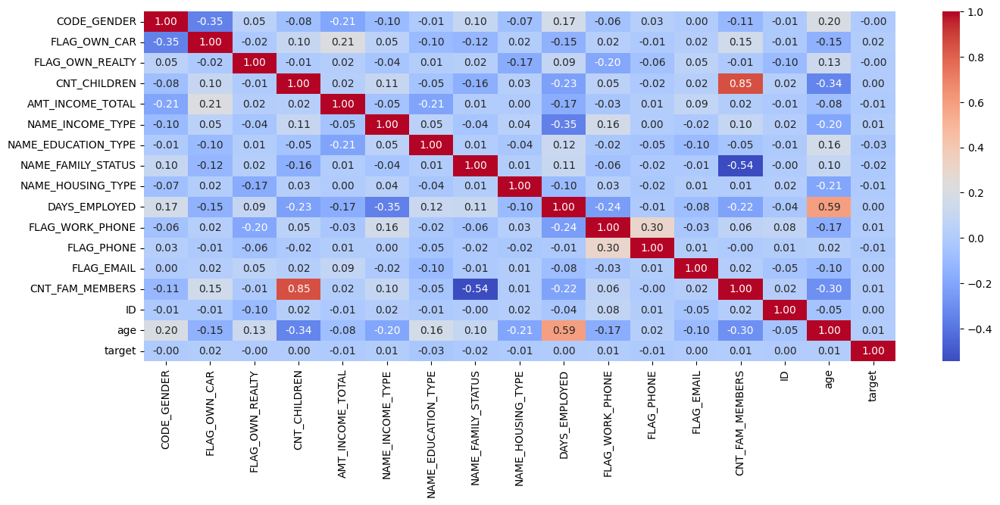

In [81]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(figsize=(16, 6))
sns.heatmap(df.corr(), cmap='coolwarm', annot=True, fmt='.2f')

plt.show()

In [82]:
#Plotting correlation to further determine importance of variables
corr = df.corr()
corr.style.background_gradient(cmap='coolwarm')

,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_EMPLOYED,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,ID,age,target
CODE_GENDER,1.000000,-0.349640,0.049159,-0.078166,-0.205082,-0.098941,-0.007197,0.099751,-0.068986,0.167041,-0.060279,0.026487,0.000398,-0.113635,-0.013146,0.195379,-0.004513
FLAG_OWN_CAR,-0.349640,1.000000,-0.017824,0.104458,0.214871,0.050946,-0.098542,-0.118140,0.015928,-0.150499,0.022692,-0.009046,0.019930,0.152354,-0.011257,-0.149196,0.016385
FLAG_OWN_REALTY,0.049159,-0.017824,1.000000,-0.006648,0.019736,-0.042445,0.010447,0.022585,-0.172635,0.089077,-0.197722,-0.061115,0.052953,-0.012226,-0.098816,0.126375,-0.000043
CNT_CHILDREN,-0.078166,0.104458,-0.006648,1.000000,0.024970,0.105787,-0.053784,-0.161624,0.026022,-0.230774,0.047561,-0.016639,0.023343,0.851346,0.024149,-0.337615,0.003468
AMT_INCOME_TOTAL,-0.205082,0.214871,0.019736,0.024970,1.000000,-0.054945,-0.211021,0.005205,0.002371,-0.170191,-0.033915,0.010746,0.087569,0.015250,-0.014703,-0.076820,-0.007383
NAME_INCOME_TYPE,-0.098941,0.050946,-0.042445,0.105787,-0.054945,1.000000,0.049152,-0.042689,0.035074,-0.353517,0.158930,0.004472,-0.019398,0.100585,0.020119,-0.204138,0.013905
NAME_EDUCATION_TYPE,-0.007197,-0.098542,0.010447,-0.053784,-0.211021,0.049152,1.000000,0.008804,-0.035030,0.118652,-0.020877,-0.045171,-0.099269,-0.045897,-0.011173,0.162645,-0.029039
NAME_FAMILY_STATUS,0.099751,-0.118140,0.022585,-0.161624,0.005205,-0.042689,0.008804,1.000000,0.010938,0.110382,-0.057983,-0.017499,-0.013349,-0.544813,-0.000668,0.098644,-0.019062
NAME_HOUSING_TYPE,-0.068986,0.015928,-0.172635,0.026022,0.002371,0.035074,-0.035030,0.010938,1.000000,-0.104248,0.025185,-0.021735,0.014102,0.007859,0.020358,-0.206243,-0.005485
DAYS_EMPLOYED,0.167041,-0.150499,0.089077,-0.230774,-0.170191,-0.353517,0.118652,0.110382,-0.104248,1.000000,-0.237450,-0.010395,-0.083918,-0.216680,-0.036829,0.592069,0.000535


DROPPING COLUMN DAYS_EMPLOYED
- It's **redundant** (highly correlated to **age**) and **unimportant** (not correlated to **target**)

In [83]:
df = df.drop('DAYS_EMPLOYED', axis=1)

DROPPING COLUMN FLAG_OWN_REALTY
- Highly **uncorrelated** to the target

In [84]:
df = df.drop('FLAG_OWN_REALTY', axis=1)

DROPPING COLUMN CNT_FAM_MEMBERS
- It's **redundant** (correlated to quantity of chidren) but barely correlated to the target

In [85]:
df = df.drop('CNT_FAM_MEMBERS', axis=1)

DROPPING ID COLUMN 

In [86]:
df = df.drop('ID', axis=1)

SCALING COLUMNS 'AMT_INCOME_TOTAL' AND 'age'

In [87]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
df['AMT_INCOME_TOTAL'] = scaler.fit_transform(df[['AMT_INCOME_TOTAL']])
df['age'] = scaler.fit_transform(df[['age']])

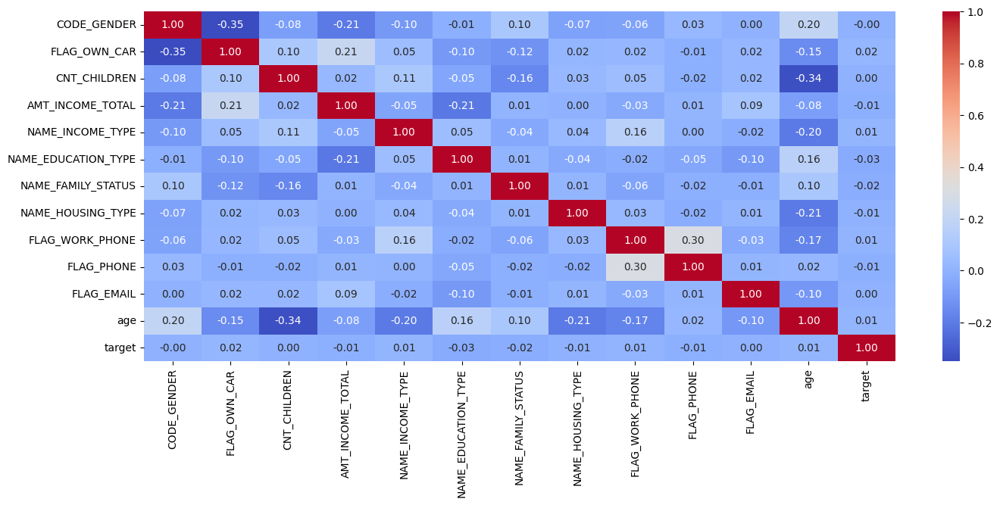

In [88]:
plt.figure(figsize=(16, 6))
sns.heatmap(df.corr(), cmap='coolwarm', annot=True, fmt='.2f')

plt.show()

PLOTTING HISTOGRAM OF VALUES BY COLUMN

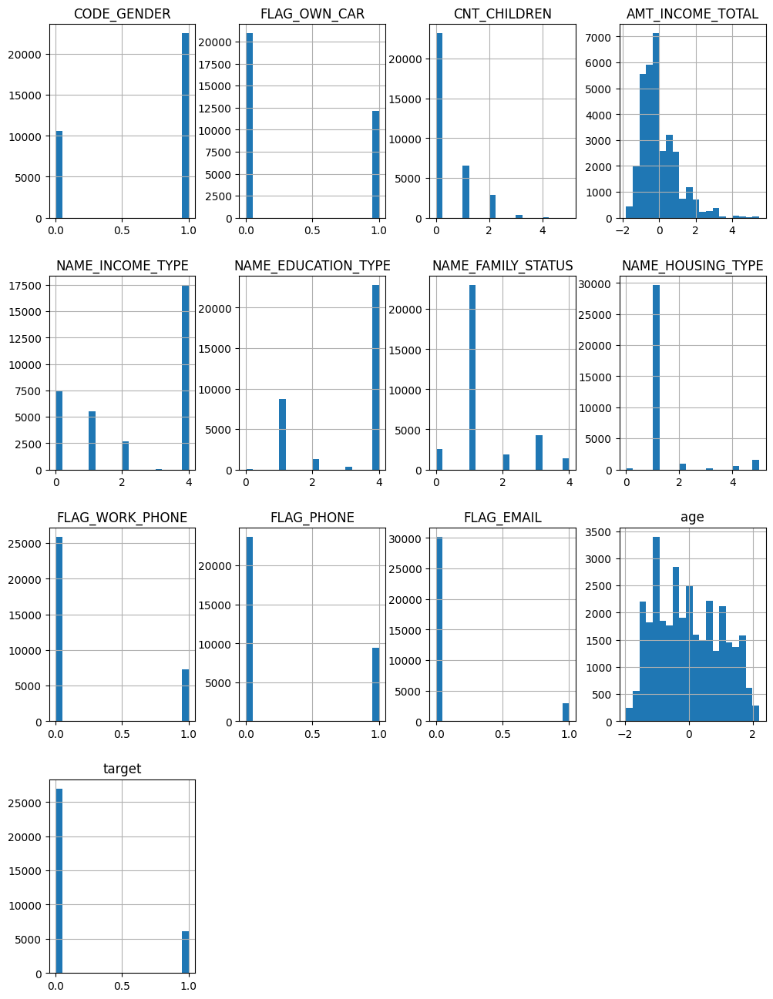

In [89]:
df.hist(bins = 20 , figsize= (12,16)) ;

In [90]:
df.dtypes

CODE_GENDER              int64
FLAG_OWN_CAR             int64
CNT_CHILDREN           float64
AMT_INCOME_TOTAL       float64
NAME_INCOME_TYPE         int32
NAME_EDUCATION_TYPE      int64
NAME_FAMILY_STATUS       int32
NAME_HOUSING_TYPE        int32
FLAG_WORK_PHONE        float64
FLAG_PHONE             float64
FLAG_EMAIL             float64
age                    float64
target                   int64
dtype: object

In [91]:
from pycaret.classification import *
s = setup(df, target = 'target', session_id = 14)

,Description,Value
0,Session id,14
1,Target,target
2,Target type,Binary
3,Original data shape,"(33110, 13)"
4,Transformed data shape,"(33110, 13)"
5,Transformed train set shape,"(23177, 13)"
6,Transformed test set shape,"(9933, 13)"
7,Numeric features,12
8,Preprocess,True
9,Imputation type,simple


In [92]:
# compare all models
best = compare_models()

,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,11:52:18
Status,. . . . . . . . . . . . . . . . . .,Loading Estimator
Estimator,. . . . . . . . . . . . . . . . . .,Logistic Regression


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)


### TESTING FEATURE IMPORTANCE WITH RANDOM FOREST CLASSIFIER

In [93]:
from sklearn.ensemble import RandomForestClassifier

# Split the data into features (X) and target (y)
X = df.drop('target', axis=1)
y = df['target']

# Create a random forest classifier with 100 trees
rf = RandomForestClassifier(n_estimators=100, random_state=42)

# Fit the random forest model
rf.fit(X, y)

# Get the feature importances from the trained model
importances = rf.feature_importances_

# Print the feature importances
for feature, importance in zip(X.columns, importances):
    print(f'{feature}: {importance:.4f}')


CODE_GENDER: 0.0291
FLAG_OWN_CAR: 0.0235
CNT_CHILDREN: 0.0530
AMT_INCOME_TOTAL: 0.3217
NAME_INCOME_TYPE: 0.0455
NAME_EDUCATION_TYPE: 0.0270
NAME_FAMILY_STATUS: 0.0617
NAME_HOUSING_TYPE: 0.0313
FLAG_WORK_PHONE: 0.0261
FLAG_PHONE: 0.0287
FLAG_EMAIL: 0.0187
age: 0.3338


RANDOM FOREST FEATURE IMPORTANCE TEST RESULTS:

- We can see that 'age' and 'AMT_INCOME_TOTAL' are important features for predicting the target variable, with 'age' having an importance of 0.3227 and 'AMT_INCOME_TOTAL' having an importance of 0.2985.

- Other features such as 'CNT_CHILDREN', 'NAME_FAMILY_STATUS', 'NAME_INCOME_TYPE', 'FLAG_WORK_PHONE', 'FLAG_PHONE', 'FLAG_EMAIL', and 'NAME_HOUSING_TYPE' also have some level of importance, but they are less important than the top two features.

- Features such as 'CODE_GENDER' and 'FLAG_OWN_CAR' have relatively low importance values, indicating that they may not be useful in predicting the target variable

### CORRELATION-BASED FEATURE SELECTION

In [94]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_regression

# X is your feature matrix, y is your target vector
# In this example, X and y are assumed to be already defined

# Select the top k features based on correlation with the target variable
k = 10  # Select the top K features
selector = SelectKBest(f_regression, k=k)
selector.fit(X, y)

# Get the scores of each feature
scores = selector.scores_

# Get the indices of the selected features
selected_indices = selector.get_support(indices=True)

# Get the names of the selected features
selected_features = X.columns[selected_indices].tolist()

# Print the scores and names of the selected features
for i in range(len(selected_features)):
    print(f"{selected_features[i]}: {scores[selected_indices[i]]:.4f}")


CODE_GENDER: 0.6743
FLAG_OWN_CAR: 8.8913
AMT_INCOME_TOTAL: 1.8047
NAME_INCOME_TYPE: 6.4028
NAME_EDUCATION_TYPE: 27.9429
NAME_FAMILY_STATUS: 12.0342
NAME_HOUSING_TYPE: 0.9960
FLAG_WORK_PHONE: 1.5031
FLAG_PHONE: 3.8053
age: 2.9694


- 'NAME_EDUCATION_TYPE' has the strongest correlation with the target variable. 
- The features 'NAME_FAMILY_STATUS' and 'FLAG_OWN_CAR' also have a relatively strong correlation with the target variable.
- The features 'FLAG_WORK_PHONE' and 'FLAG_PHONE' have a moderate correlation with the target variable. 
- 'AMT_INCOME_TOTAL', 'CNT_CHILDREN', 'CODE_GENDER', and 'NAME_HOUSING_TYPE' have a weaker correlation with the target variable. The feature 'CODE_GENDER' also shows a weak correlation.

### PERMUTATION IMPORTANCE

In [95]:
from sklearn.inspection import permutation_importance
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import make_classification

# Generate some random classification data
X, y = make_classification(n_samples=1000, n_features=10, n_informative=5, n_redundant=0, random_state=42)

# Train a random forest classifier
rfc = RandomForestClassifier(n_estimators=100, random_state=42)
rfc.fit(X, y)

# Calculate permutation feature importance
result = permutation_importance(rfc, X, y, n_repeats=10, random_state=42)

# Print the feature importances
for i in result.importances_mean.argsort()[::-1]:
    print(f"{df.columns[i]:<20}: {result.importances_mean[i]:.3f}")



NAME_INCOME_TYPE    : 0.246
FLAG_WORK_PHONE     : 0.185
CNT_CHILDREN        : 0.149
NAME_HOUSING_TYPE   : 0.056
CODE_GENDER         : 0.021
AMT_INCOME_TOTAL    : 0.004
FLAG_PHONE          : 0.004
FLAG_OWN_CAR        : 0.003
NAME_FAMILY_STATUS  : 0.002
NAME_EDUCATION_TYPE : 0.002


CONCLUSIONS:
- 'age', 'AMT_INCOME_TOTAL', and 'CNT_CHILDREN' are consistently among the top features across **all three methods**. This indicates that these features are likely to have a strong influence on the target variable and should be considered important in predicting the target.

- Additionally, we see that 'NAME_EDUCATION_TYPE' and 'NAME_FAMILY_STATUS' are among the top features selected by both **correlation-based feature selection** and **random forest classifier feature importance**. This suggests that these features may be especially important in predicting the target and should be given additional consideration.

- On the other hand, the **permutation importance method** yields somewhat different results, with 'NAME_INCOME_TYPE', 'FLAG_WORK_PHONE', and 'NAME_HOUSING_TYPE' being the top three features. 

ASSESSING TARGET IMBALANCE IN DATASET

In [96]:
df.target.value_counts()

0    26972
1     6138
Name: target, dtype: int64

In [97]:
print(X.shape)
print(y.shape)

(1000, 10)
(1000,)


In [98]:
df.shape

(33110, 13)

### SPLITTING DATASET INTO TRAINING/VALIDATION/TEST SETS

In [99]:
# Split the new_df DataFrame into train, test, and validation sets with a 90/5/5 ratio.
# train set = first 240,000 rows, test set = next 22,000 rows, validation set = last 22,000 rows.
train, test, val = df[:22000], df[22000:28000], df[28000:]

# Count the number of occurrences of each class label in the train, test, and validation sets, respectively.
train['target'].value_counts(), test['target'].value_counts(), val['target'].value_counts()

(0    17920
 1     4080
 Name: target, dtype: int64,
 0    4801
 1    1199
 Name: target, dtype: int64,
 0    4251
 1     859
 Name: target, dtype: int64)

In [100]:
# Convert train/test/val DataFrame to NumPy array
train_np, test_np, val_np = train.to_numpy(), test.to_numpy(), val.to_numpy()

train_np.shape, test_np.shape, val_np.shape

((22000, 13), (6000, 13), (5110, 13))

In [101]:
# extract feature and target arrays from the train, test, and validation sets
X_train, y_train = train_np[:, :-1], train_np[:, -1]
X_test, y_test = test_np[:, :-1], test_np[:, -1]
X_val, y_val = val_np[:, :-1], val_np[:, -1]

print(X_train.shape, y_train.shape, X_test.shape, y_test.shape, X_val.shape, y_val.shape)

(22000, 12) (22000,) (6000, 12) (6000,) (5110, 12) (5110,)


COMPARING MODEL PERFORMANCE TO CHOOSE OUR FIRST MODEL

In [102]:
from pycaret.classification import * 

s = setup(df, target = 'target', session_id = 14)

In [103]:
# compare all models
best = compare_models()

,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,11:54:10
Status,. . . . . . . . . . . . . . . . . .,Loading Estimator
Estimator,. . . . . . . . . . . . . . . . . .,Logistic Regression


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)


When dealing with an imbalanced dataset, accuracy alone may not be a good metric to evaluate the performance of a model. This is because the model can achieve a high accuracy by simply predicting the majority class, while performing poorly on the minority class.

Here are some metrics that can be more appropriate for imbalanced datasets:

- **Precision**: Precision measures the proportion of positive predictions that are actually true positives. It is useful when the cost of false positives is high, such as in medical diagnosis or fraud detection.

- **Recall**: Recall measures the proportion of true positives that are correctly identified by the model. It is useful when the cost of false negatives is high, such as in disease detection or credit risk assessment.

- **F1 score**: F1 score is the harmonic mean of precision and recall, and provides a balanced measure of the model's performance on both classes.

- **ROC AUC**: Receiver Operating Characteristic (ROC) curve plots the true positive rate (TPR) against the false positive rate (FPR) at different classification thresholds. Area under the ROC curve (AUC) is a single-number summary of the model's performance, where a value of 1 indicates a perfect classifier, while a value of 0.5 indicates a random classifier.

- **Precision-Recall (PR) curve**: PR curve plots precision against recall at different classification thresholds. The area under the PR curve (PR AUC) is another metric that provides a balanced measure of the model's performance on both classes. It is useful when the positive class is rare and/or the cost of false positives and false negatives is not equal.

RANDOM FOREST CLASSIFIER

In [104]:
from sklearn.ensemble import RandomForestClassifier  
from sklearn.metrics import classification_report
# Initializing a new instance of the RandomForestClassifier with max_depth 2 and n_jobs -1 (uses all available CPU cores)
rf = RandomForestClassifier(n_estimators=100,
                            class_weight='balanced', #important for imbalanced datasets
                            max_depth=2, 
                            n_jobs=-1)
# Training the random forest model on the training data
rf.fit(X_train, y_train)

# Printing the classification report
print(classification_report(y_val, rf.predict(X_val), target_names=['0', '1']))

              precision    recall  f1-score   support

           0       0.84      0.51      0.64      4251
           1       0.18      0.53      0.27       859

    accuracy                           0.52      5110
   macro avg       0.51      0.52      0.45      5110
weighted avg       0.73      0.52      0.58      5110



DECISION TREE CLASSIFIER

In [105]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report

# Instantiate the classifier with class weights and max depth hyperparameters set
clf = DecisionTreeClassifier(class_weight='balanced', max_depth=5)

# Fit the model to the training data
clf.fit(X_train, y_train)

# Predict on the validation set
y_pred = clf.predict(X_val)

# Print the classification report
print(classification_report(y_val, y_pred))


              precision    recall  f1-score   support

         0.0       0.85      0.45      0.59      4251
         1.0       0.18      0.59      0.27       859

    accuracy                           0.48      5110
   macro avg       0.51      0.52      0.43      5110
weighted avg       0.73      0.48      0.54      5110



GRADIENT BOOSTING CLASSIFIER

In [106]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import classification_report

# Define the gradient boosting classifier with balanced class weights
gb_clf = GradientBoostingClassifier(random_state=42, 
                                    n_estimators=100, 
                                    max_depth=5, 
                                    learning_rate=0.01, 
                                    )

# Train the model on the training data
gb_clf.fit(X_train, y_train)

# Make predictions on the validation data
y_pred = gb_clf.predict(X_val)

# Print the classification report
print(classification_report(y_val, y_pred))


              precision    recall  f1-score   support

         0.0       0.83      1.00      0.91      4251
         1.0       0.00      0.00      0.00       859

    accuracy                           0.83      5110
   macro avg       0.42      0.50      0.45      5110
weighted avg       0.69      0.83      0.76      5110



LOGISTIC REGRESSION

In [107]:
from sklearn.linear_model import LogisticRegression

lr = LogisticRegression(class_weight='balanced')
lr.fit(X_train, y_train)
print(classification_report(y_val, lr.predict(X_val), target_names=['0', '1']))

              precision    recall  f1-score   support

           0       0.84      0.55      0.66      4251
           1       0.18      0.50      0.27       859

    accuracy                           0.54      5110
   macro avg       0.51      0.52      0.46      5110
weighted avg       0.73      0.54      0.60      5110



LINEAR SUPPORT VECTOR CLASSIFIER

In [108]:
from sklearn.svm import LinearSVC

svc = LinearSVC(class_weight='balanced')
svc.fit(X_train, y_train)

print(classification_report(y_val, svc.predict(X_val), target_names=['0', '1']))

              precision    recall  f1-score   support

           0       0.84      0.55      0.67      4251
           1       0.18      0.49      0.27       859

    accuracy                           0.54      5110
   macro avg       0.51      0.52      0.47      5110
weighted avg       0.73      0.54      0.60      5110



ADA BOOST CLASSIFIER

In [109]:
from sklearn.ensemble import AdaBoostClassifier
from sklearn.metrics import classification_report

# Create an AdaBoost classifier object
ada = AdaBoostClassifier(n_estimators=100, random_state=42)

# Train the model
ada.fit(X_train, y_train)

# Make predictions on the validation set
y_pred = ada.predict(X_val)

# Print classification report
print(classification_report(y_val, y_pred))


              precision    recall  f1-score   support

         0.0       0.83      1.00      0.91      4251
         1.0       0.00      0.00      0.00       859

    accuracy                           0.83      5110
   macro avg       0.42      0.50      0.45      5110
weighted avg       0.69      0.83      0.75      5110



NEURAL NETWORK

In [110]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import InputLayer, Dense, BatchNormalization
from tensorflow.keras.callbacks import ModelCheckpoint


# initialize shallow neural network
nn = Sequential()
# add input layer with shape matching input data
nn.add(Dense(8, input_dim=len(X_train[0,:]), activation='relu'))
# add hidden layer with 2 neurons and ReLU activation function
nn.add(Dense(4, 'relu'))
# add batch normalization layer to normalize layer inputs (learn the data better)
nn.add(BatchNormalization())
# add output layer with 1 neuron and sigmoid activation function
nn.add(Dense(1, 'sigmoid')) #sigmoid for classification [0,1]


# define model checkpoint to save best model during training
checkpoint = ModelCheckpoint('nn', save_best_only=True)


In [111]:

# compile model with Adam optimizer, binary crossentropy loss function, and accuracy metric
nn.compile(optimizer='adam', 
                    loss='binary_crossentropy', 
                    metrics=['accuracy'])


In [112]:
nn.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 8)                 104       
                                                                 
 dense_1 (Dense)             (None, 4)                 36        
                                                                 
 batch_normalization (BatchN  (None, 4)                16        
 ormalization)                                                   
                                                                 
 dense_2 (Dense)             (None, 1)                 5         
                                                                 
Total params: 161
Trainable params: 153
Non-trainable params: 8
_________________________________________________________________


In [113]:
from sklearn.utils.class_weight import compute_class_weight

class_weights = compute_class_weight('balanced', classes=np.unique(y_train), y=y_train)

nn.fit(X_train, y_train, 
                validation_data=(X_val, y_val), 
                epochs=5, 
                callbacks=checkpoint)

Epoch 1/5
673/688 [============================>.] - ETA: 0s - loss: 0.5630 - accuracy: 0.7501

INFO:tensorflow:Assets written to: nn\assets


INFO:tensorflow:Assets written to: nn\assets


688/688 [==============================] - 7s 7ms/step - loss: 0.5619 - accuracy: 0.7512 - val_loss: 0.4594 - val_accuracy: 0.8319
Epoch 2/5
682/688 [============================>.] - ETA: 0s - loss: 0.4818 - accuracy: 0.8142

INFO:tensorflow:Assets written to: nn\assets


INFO:tensorflow:Assets written to: nn\assets


688/688 [==============================] - 4s 5ms/step - loss: 0.4815 - accuracy: 0.8144 - val_loss: 0.4551 - val_accuracy: 0.8319
Epoch 3/5
688/688 [==============================] - 2s 3ms/step - loss: 0.4796 - accuracy: 0.8145 - val_loss: 0.4565 - val_accuracy: 0.8319
Epoch 4/5
678/688 [============================>.] - ETA: 0s - loss: 0.4786 - accuracy: 0.8149

INFO:tensorflow:Assets written to: nn\assets


INFO:tensorflow:Assets written to: nn\assets


688/688 [==============================] - 4s 5ms/step - loss: 0.4793 - accuracy: 0.8145 - val_loss: 0.4534 - val_accuracy: 0.8319
Epoch 5/5
688/688 [==============================] - 2s 3ms/step - loss: 0.4789 - accuracy: 0.8145 - val_loss: 0.4545 - val_accuracy: 0.8319


In [114]:
# Define a function to generate binary classification predictions using a neural network model and input features
def neural_net_predictions(model, x):
    return (model.predict(x).flatten() > 0.5).astype(int)

# Generate binary classification predictions for the validation set using the shallow neural network model
neural_net_predictions(nn, X_val)

160/160 [==============================] - 0s 2ms/step


array([0, 0, 0, ..., 0, 0, 0])

In [115]:
print(classification_report(y_val, neural_net_predictions(nn, X_val), target_names=['0', '1']))

160/160 [==============================] - 0s 2ms/step
              precision    recall  f1-score   support

           0       0.83      1.00      0.91      4251
           1       0.00      0.00      0.00       859

    accuracy                           0.83      5110
   macro avg       0.42      0.50      0.45      5110
weighted avg       0.69      0.83      0.76      5110



### SYNTHETIC MINORITY OVERSAMPLING TECHNIQUE (SMOTE)

In [116]:
from imblearn.over_sampling import SMOTE
smote = SMOTE()

In [117]:
X_train_smote, y_train_smote = smote.fit_resample(X_train.astype('float'),y_train)

In [118]:
from collections import Counter
print("Before SMOTE :" , Counter(y_train))
print("After SMOTE :" , Counter(y_train_smote))

Before SMOTE : Counter({0.0: 17920, 1.0: 4080})
After SMOTE : Counter({1.0: 17920, 0.0: 17920})


In [119]:
from sklearn.ensemble import RandomForestClassifier  
from sklearn.metrics import classification_report
# Initializing a new instance of the RandomForestClassifier with max_depth 2 and n_jobs -1 (uses all available CPU cores)
rf = RandomForestClassifier(n_estimators=100,
                            #class_weight='balanced', #important for imbalanced datasets
                            max_depth=2, 
                            n_jobs=-1)
# Training the random forest model on the training data
rf.fit(X_train_smote, y_train_smote)

# Printing the classification report
print(classification_report(y_val, rf.predict(X_val), target_names=['0', '1']))

              precision    recall  f1-score   support

           0       0.83      0.45      0.58      4251
           1       0.17      0.54      0.25       859

    accuracy                           0.46      5110
   macro avg       0.50      0.50      0.42      5110
weighted avg       0.72      0.46      0.53      5110



### CREATING A SMALLER, TARGET BALANCED DATASET

In [120]:
# Separate the dataframe into frauds and not frauds
not_eligible = df.query('target == 0')
eligible = df.query('target == 1')

# Print the number of samples for each class
print(not_eligible['target'].value_counts())
print(eligible['target'].value_counts())

0    26972
Name: target, dtype: int64
1    6138
Name: target, dtype: int64


In [121]:
# Create a balanced dataset by concatenating fraud and non-fraud transactions with equal length
balanced_df = pd.concat([eligible, not_eligible.sample(len(eligible), random_state=1)])
balanced_df['target'].value_counts()

1    6138
0    6138
Name: target, dtype: int64

In [122]:
# shuffle the balanced data
balanced_df = balanced_df.sample(frac=1, random_state=1)
balanced_df

,CODE_GENDER,FLAG_OWN_CAR,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,age,target
2639,1,1,1.0,-0.279979,4,4,1,1,0.0,1.0,1.0,-1.090399,0
25793,0,0,0.0,-0.645749,0,4,1,1,0.0,0.0,0.0,0.034185,1
24021,0,1,0.0,1.548868,4,1,1,1,0.0,0.0,0.0,0.639729,0
4769,1,0,0.0,-0.018715,0,4,1,1,0.0,0.0,0.0,1.850819,0
17704,0,1,0.0,-0.279979,4,4,1,1,0.0,1.0,0.0,1.504794,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
30246,0,1,0.0,1.548868,4,2,1,1,0.0,0.0,0.0,-1.263412,0
5212,1,0,1.0,-0.018715,2,4,1,1,0.0,1.0,1.0,-0.311841,1
27642,1,1,0.0,-0.541243,4,3,1,1,0.0,1.0,0.0,0.120691,1
4118,0,0,0.0,-0.802507,4,4,1,1,1.0,0.0,0.0,-0.484854,0


SPLITTING NEW DATASET

In [123]:
# train set = first 240,000 rows, test set = next 22,000 rows, validation set = last 22,000 rows.
train, test, val = balanced_df[:8000], balanced_df[8000:10000], balanced_df[10000:]

# Count the number of occurrences of each class label in the train, test, and validation sets, respectively.
train['target'].value_counts(), test['target'].value_counts(), val['target'].value_counts()

(1    4044
 0    3956
 Name: target, dtype: int64,
 0    1024
 1     976
 Name: target, dtype: int64,
 0    1158
 1    1118
 Name: target, dtype: int64)

In [124]:
# Convert train/test/val DataFrame to NumPy array
train_np, test_np, val_np = train.to_numpy(), test.to_numpy(), val.to_numpy()

train_np.shape, test_np.shape, val_np.shape

((8000, 13), (2000, 13), (2276, 13))

In [125]:
# extract feature and target arrays from the train, test, and validation sets
X_train, y_train = train_np[:, :-1], train_np[:, -1]
X_test, y_test = test_np[:, :-1], test_np[:, -1]
X_val, y_val = val_np[:, :-1], val_np[:, -1]

print(X_train.shape, y_train.shape, X_test.shape, y_test.shape, X_val.shape, y_val.shape)

(8000, 12) (8000,) (2000, 12) (2000,) (2276, 12) (2276,)


RANDOM FOREST CLASSIFIER

In [126]:
# Initializing a new instance of the RandomForestClassifier with max_depth 2 and n_jobs -1 (uses all available CPU cores)
rf = RandomForestClassifier(n_estimators=100,
                            class_weight='balanced', #important for imbalanced datasets
                            max_depth=2, 
                            n_jobs=-1)
# Training the random forest model on the training data
rf.fit(X_train, y_train)

# Printing the classification report
print(classification_report(y_val, rf.predict(X_val), target_names=['0', '1']))

              precision    recall  f1-score   support

           0       0.53      0.63      0.58      1158
           1       0.52      0.42      0.47      1118

    accuracy                           0.53      2276
   macro avg       0.53      0.53      0.52      2276
weighted avg       0.53      0.53      0.52      2276



DECISION TREE CLASSIFIER

In [127]:
# Instantiate the classifier with class weights and max depth hyperparameters set
clf = DecisionTreeClassifier(class_weight='balanced', max_depth=5)

# Fit the model to the training data
clf.fit(X_train, y_train)

# Predict on the validation set
y_pred = clf.predict(X_val)

# Print the classification report
print(classification_report(y_val, y_pred))

              precision    recall  f1-score   support

         0.0       0.52      0.64      0.57      1158
         1.0       0.51      0.40      0.45      1118

    accuracy                           0.52      2276
   macro avg       0.52      0.52      0.51      2276
weighted avg       0.52      0.52      0.51      2276



GRADIENT BOOSTING CLASSIFIER

In [128]:
# Define the gradient boosting classifier with balanced class weights
gb_clf = GradientBoostingClassifier(random_state=42, 
                                    n_estimators=100, 
                                    max_depth=5, 
                                    learning_rate=0.1, 
                                    )

# Train the model on the training data
gb_clf.fit(X_train, y_train)

# Make predictions on the validation data
y_pred = gb_clf.predict(X_val)

# Print the classification report
print(classification_report(y_val, y_pred))

              precision    recall  f1-score   support

         0.0       0.58      0.52      0.55      1158
         1.0       0.55      0.61      0.58      1118

    accuracy                           0.57      2276
   macro avg       0.57      0.57      0.57      2276
weighted avg       0.57      0.57      0.57      2276



NEURAL NETWORK

In [129]:
# initialize shallow neural network
nn = Sequential()
# add input layer with shape matching input data
nn.add(Dense(8, input_dim=len(X_train[0,:]), activation='relu'))
# add hidden layer with 2 neurons and ReLU activation function
nn.add(Dense(4, 'relu'))
# add batch normalization layer to normalize layer inputs (learn the data better)
nn.add(BatchNormalization())
# add output layer with 1 neuron and sigmoid activation function
nn.add(Dense(1, 'sigmoid')) #sigmoid for classification [0,1]

# define model checkpoint to save best model during training
checkpoint = ModelCheckpoint('nn', save_best_only=True)

In [130]:
# compile model with Adam optimizer, binary crossentropy loss function, and accuracy metric
nn.compile(optimizer='adam', 
                    loss='binary_crossentropy', 
                    metrics=['accuracy'])

In [131]:
class_weights = compute_class_weight('balanced', classes=np.unique(y_train), y=y_train)

nn.fit(X_train, y_train, 
                validation_data=(X_val, y_val), 
                epochs=5, 
                callbacks=checkpoint)

Epoch 1/5
245/250 [============================>.] - ETA: 0s - loss: 0.7670 - accuracy: 0.4918

INFO:tensorflow:Assets written to: nn\assets


INFO:tensorflow:Assets written to: nn\assets


250/250 [==============================] - 4s 11ms/step - loss: 0.7663 - accuracy: 0.4913 - val_loss: 0.7200 - val_accuracy: 0.5000
Epoch 2/5
246/250 [============================>.] - ETA: 0s - loss: 0.7116 - accuracy: 0.4985

INFO:tensorflow:Assets written to: nn\assets


INFO:tensorflow:Assets written to: nn\assets


250/250 [==============================] - 3s 10ms/step - loss: 0.7112 - accuracy: 0.5002 - val_loss: 0.7015 - val_accuracy: 0.5009
Epoch 3/5
237/250 [===========================>..] - ETA: 0s - loss: 0.7009 - accuracy: 0.5025

INFO:tensorflow:Assets written to: nn\assets


INFO:tensorflow:Assets written to: nn\assets


250/250 [==============================] - 3s 10ms/step - loss: 0.7005 - accuracy: 0.5041 - val_loss: 0.6970 - val_accuracy: 0.5040
Epoch 4/5
244/250 [============================>.] - ETA: 0s - loss: 0.6961 - accuracy: 0.5127

INFO:tensorflow:Assets written to: nn\assets


INFO:tensorflow:Assets written to: nn\assets


250/250 [==============================] - 2s 9ms/step - loss: 0.6961 - accuracy: 0.5123 - val_loss: 0.6964 - val_accuracy: 0.5141
Epoch 5/5
237/250 [===========================>..] - ETA: 0s - loss: 0.6938 - accuracy: 0.5162

INFO:tensorflow:Assets written to: nn\assets


INFO:tensorflow:Assets written to: nn\assets


250/250 [==============================] - 3s 11ms/step - loss: 0.6940 - accuracy: 0.5148 - val_loss: 0.6929 - val_accuracy: 0.5308


In [132]:
# Define a function to generate binary classification predictions using a neural network model and input features
def neural_net_predictions(model, x):
    return (model.predict(x).flatten() > 0.5).astype(int)

# Generate binary classification predictions for the validation set using the shallow neural network model
neural_net_predictions(nn, X_val)

72/72 [==============================] - 0s 2ms/step


array([0, 0, 0, ..., 1, 0, 1])

In [133]:
print(classification_report(y_val, neural_net_predictions(nn, X_val), target_names=['0', '1']))

72/72 [==============================] - 0s 2ms/step
              precision    recall  f1-score   support

           0       0.53      0.70      0.60      1158
           1       0.53      0.35      0.43      1118

    accuracy                           0.53      2276
   macro avg       0.53      0.53      0.51      2276
weighted avg       0.53      0.53      0.52      2276

